## Library importing

In [1]:
import getpass
import re
import itertools
import string
import gc

import sqlalchemy

import pandas as pd
import numpy as np
from bs4 import BeautifulSoup

from wordcloud import WordCloud, STOPWORDS
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords, wordnet
from nltk.stem import WordNetLemmatizer
from nltk.tag import pos_tag

import seaborn as sns
import matplotlib.pyplot as plt

## Utilities and settings

In [2]:
sns.set_palette("bright")
sns.set_theme()

def ConnectDataBase() -> sqlalchemy.create_engine:
    
    username = input("User postgres:")
    host = input("Host:")
    database = input("Database:")
    password = getpass.getpass("Password:")

    engine = sqlalchemy.create_engine(f'postgresql://{username}:{password}@{host}/{database}')
    return engine

def CreateWordCloud(text:str, stop_words:iter):
    
    wordcloud = WordCloud(width = 1080, height = 720,
                stopwords = stop_words,
                background_color="white",
                min_font_size = 10).generate(text)
    
    return wordcloud

def GetContextWords(sentence_tokens:list, context_len:int = 2) -> list:
    
    context_tokens, max_index, context_words = [], len(sentence_tokens) - 1, context_len

    for index, token in enumerate(sentence_tokens):
        
        if token.find("video") > -1:
        
            start_left = 0 if (index - context_words) < 0 else (index - context_words)
            left_context = sentence_tokens[start_left:index]
        
            try:
                righ_context = sentence_tokens[index + 1:index + context_words + 1]
            except:
                righ_context = []
            
            context_tokens.extend(left_context + righ_context)
    
    return context_tokens

class CleanText:
    
    def __init__(self):
        
        self.r_link_compiled = self.__RemoveLinksPattern()
        self.r_punc_compiled = self.__RemovePunctuationsPattern()
        self.r_nonp_compiled = self.__RemoveNonPrintablePattern()
        self.r_emoj_compiled = self.__RemoveEmojisPattern()
        self.r_whit_compiled = self.__RemoveWhiteSpaces()
        self.r_hash_compiled = self.__RemoveHashTagsPattern()
        self.r_ment_compiled = self.__RemoveMentionsPattern()
        
        
    def __RemoveHtml(self, text):
        return BeautifulSoup(text, "lxml").text

    def __RemoveLinksPattern(self):
        return re.compile(r'https?://\S+')

    def __RemovePunctuationsPattern(self):
        punctuations = string.punctuation.replace("?","").replace("'","").replace("!","")
        punctuations = punctuations.replace(".","").replace("%","").replace("#","").replace("$","")
        return re.compile(r'[' + re.escape(punctuations) + ']+')
    
    def __RemoveNonPrintablePattern(self):
        return re.compile(r'[\x00-\x08\x0B\x0C\x0E-\x1F\x7F\r]')

    def __RemoveEmojisPattern(self):
        emoji_patterns = re.compile("["
            u"\U0001F600-\U0001F64F"
            u"\U0001F300-\U0001F5FF"
            u"\U0001F680-\U0001F6FF"
            u"\U0001F1E0-\U0001F1FF"
            u"\U00002500-\U00002BEF"
            u"\U00002702-\U000027B0"
            u"\U00002702-\U000027B0"
            u"\U000024C2-\U0001F251"
            u"\U0001f926-\U0001f937"
            u"\U00010000-\U0010ffff"
            u"\u2640-\u2642" 
            u"\u2600-\u2B55"
            u"\u200d"
            u"\u23cf"
            u"\u23e9"
            u"\u231a"
            u"\ufe0f"
            u"\u3030"
                          "]+", re.UNICODE)
        
        return emoji_patterns
    
    def __RemoveWhiteSpaces(self):
        return re.compile(r"\s+")
    
    def __RemoveHashTagsPattern(self):
        return re.compile(r'#\w+')
    
    def __RemoveMentionsPattern(self):
        return re.compile(r'@\w+')

    def Cleaner(self, text:str, on:str = "youtube"):
        
        '''
        Parameters
        ----------
        
        text:str
            Text to clean
        
        on:str; ["twitter","youtube"]
            If on='twitter', add some extra steps to clean mentions @ and hashtags #
        
        '''
        
        clean_text = str(text).lower()
        clean_text = self.r_link_compiled.sub(" ", clean_text)
        clean_text = self.__RemoveHtml(clean_text)
        
        if on == "twitter":
            clean_text = self.r_hash_compiled.sub(" ", clean_text)
            clean_text = self.r_ment_compiled.sub(" ", clean_text)
        
        clean_text = self.r_emoj_compiled.sub(" ", clean_text)
        clean_text = self.r_nonp_compiled.sub(" ", clean_text)
        clean_text = self.r_punc_compiled.sub(" ", clean_text)
        clean_text = self.r_whit_compiled.sub(" ", clean_text)
        
        return clean_text
    
def ContainsAscii(text):
    pattern = re.compile(r'^[“”’\x00-\x7F]+$')
    return bool(pattern.search(text))

def IsEmptyString(text):
    return bool(re.search(r"^\s*$", text))

def StringLen(text):
    return len(str(text))

def TruncateText(text, max_length):
    return str(text)[:max_length]

def RemoveStopWords(sentence:str) -> str:
    return re.sub(fr"\b(?:{'|'.join(stop_words)})\b", " ", sentence)

stop_words_word = set(STOPWORDS)
stop_words_nltk = set(stopwords.words("english"))

stop_words = stop_words_word.union(stop_words_nltk)

def LemmatizeWithPos(text, as_list = True):
    
    lemmatizer = WordNetLemmatizer()
    
    pos_tag_dict = {
        "J": wordnet.ADJ,
        "N": wordnet.NOUN,
        "V": wordnet.VERB,
        "R": wordnet.ADV
    }
    
    tokens = word_tokenize(text)
    pos = pos_tag(tokens)
    new_sentence = []
        
    for token, tag_pos in pos:
        
        first_letter_pos = tag_pos[0].upper() 
        word_net_value = pos_tag_dict.get(first_letter_pos, "n")
        lemma = lemmatizer.lemmatize(word = token, pos = word_net_value)

        new_sentence.append(lemma)
        
    if as_list:
        return new_sentence
    else:
        return " ".join(new_sentence)
    

## Retrieving data

In [3]:
engine = ConnectDataBase()

User postgres: postgres
Host: localhost
Database: youtube
Password: ········


In [4]:
query = "SELECT c.comment, c.published_date, c.likes, u.name, t.title FROM comments AS c \
            LEFT JOIN users AS u ON c.id_user=u.id_user \
            LEFT JOIN titles AS t ON c.id_video=t.id_video \
            LEFT JOIN languages AS l on c.id_language=l.id_language \
        WHERE l.code = 'en'"

comments_df = pd.read_sql(query, engine)
engine.dispose()

comments_df.head()

,comment,published_date,likes,name,title
0,Head over to our shop to get exclusive kurzges...,2019-02-08,3292,Kurzgesagt – In a Nutshell,What Happened Before History? Human Origins
1,"6 different types of humans, that's wild,mind ...",2023-05-21,0,JET LIFE,What Happened Before History? Human Origins
2,You think primitive human woman wore bikinis t...,2023-05-20,0,bob hope,What Happened Before History? Human Origins
3,"i wish we never had left the caves, humans are...",2023-05-20,0,Rafael Olegário,What Happened Before History? Human Origins
4,This together with the clip on kardashev scale...,2023-05-19,0,Roxy,What Happened Before History? Human Origins


In [11]:
comments_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 138679 entries, 0 to 138678
Data columns (total 5 columns):
 #   Column          Non-Null Count   Dtype 
---  ------          --------------   ----- 
 0   comment         138679 non-null  object
 1   published_date  138679 non-null  object
 2   likes           138679 non-null  int64 
 3   name            138679 non-null  object
 4   title           138679 non-null  object
dtypes: int64(1), object(4)
memory usage: 5.3+ MB


In [12]:
comments_df["published_date"] = pd.to_datetime(comments_df["published_date"], format="%Y-%m-%d")
comments_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 138679 entries, 0 to 138678
Data columns (total 5 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   comment         138679 non-null  object        
 1   published_date  138679 non-null  datetime64[ns]
 2   likes           138679 non-null  int64         
 3   name            138679 non-null  object        
 4   title           138679 non-null  object        
dtypes: datetime64[ns](1), int64(1), object(3)
memory usage: 5.3+ MB


## EDA

### kurzgesagt comments

#### Video interaction by N° comments

The interaction of users in the video is based on the number of comments over time, as shown below. Notice the peak in comments for the **What if We Nuke a City?** video coinciding with the dates when the Ukraine-Russia war started.

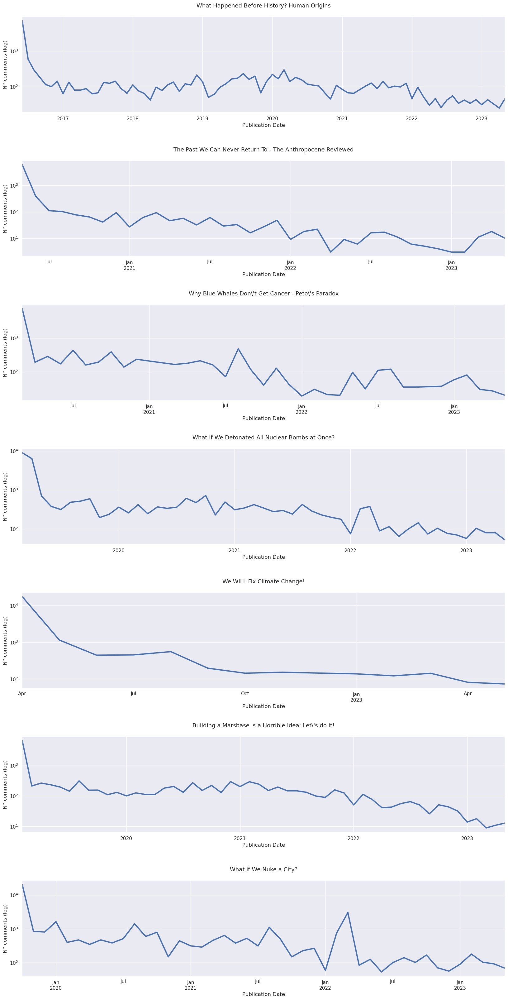

In [7]:
videos = comments_df.title.unique()

fig, axis = plt.subplots(videos.shape[0], 1, figsize=(20, 40))

for video_title, ax in zip(videos, axis):

    video_title = video_title.replace("'","\\'")
    video_title = video_title.replace('"', '\\"')
    
    metrics_video = comments_df.query(f"title == '{video_title}'")
    interactions_by_date = metrics_video[["published_date", "comment"]].resample("m", on="published_date")
    interactions_by_date = interactions_by_date.count()
    
    interactions_by_date.plot.line(ax=ax, logy=True, legend=False, linewidth=3)
    
    ax.set_xlabel("Publication Date")
    ax.set_ylabel("N° comments (log)")
    
    ax.set_title(video_title + "\n", fontdict={"size":13})
    
fig.subplots_adjust(hspace=0.5)
plt.show()

#### Popular comments and other stuffs

Here is the total number of comments for each chosen video, in our case, for the YouTube channel **Kurzgesagt – In a Nutshell**. Note that the comments taken into account are only the parent comments. Comments nested to other comments were not taken into account.

In [8]:
blues_cm = sns.color_palette("Blues", as_cmap=True)

popular_videos_by_comments = comments_df[["comment","title"]]
popular_videos_by_comments = popular_videos_by_comments.groupby("title").count()
popular_videos_by_comments = popular_videos_by_comments.sort_values(by="comment",
                                                                    ascending=False)

popular_videos_by_comments.rename({"comment":"N° comments"},
                                  axis=1, inplace=True)

popular_videos_by_comments.index.rename("Video title", inplace=True)
popular_videos_by_comments.style.background_gradient(cmap=blues_cm)

,N° comments
Video title,
What if We Nuke a City?,40006
What If We Detonated All Nuclear Bombs at Once?,28963
We WILL Fix Climate Change!,20948
What Happened Before History? Human Origins,15977
Building a Marsbase is a Horrible Idea: Let's do it!,12872
Why Blue Whales Don't Get Cancer - Peto's Paradox,12297
The Past We Can Never Return To - The Anthropocene Reviewed,7616


In [9]:
def ApplyStyleMultiIndex(df, cmap, target_column):
    
    df = pd.DataFrame(df)
    style_df = pd.DataFrame(index=df.index,columns=df.columns)
    pattern_background_color = re.compile(r"(background-color#\w+)+")
    pattern_text_color = re.compile(r"\\(color#\w+)+")
    
    for index, group in df.groupby(level=0):
        
        group = pd.DataFrame(group).style.background_gradient(cmap=blues_cm)
        latex_group = group.to_latex()
        
        colors_background = pattern_background_color.findall(latex_group)
        colors_text = pattern_text_color.findall(latex_group)
        
        colors_background = [c.replace("#",": #") for c in colors_background]
        colors_text = [c.replace("#",": #") for c in colors_text]
        
        colors = [ct + ";" + cb for ct, cb in zip(colors_text, colors_background)]
        
        style_df.loc[group.index, target_column] = colors
        
    return style_df

The following table shows the users with the greatest number of comments for each video. For example, in the video **We WILL Fix Climate Change!**, the user _der Preusse_ has the highest number of comments, with a total of 61, surpassing all other users.

In [10]:
# Top 5 by videos

most_active_users_by_video = comments_df[["name","comment","title"]].groupby(["title","name"])
most_active_users_by_video = most_active_users_by_video.count()

most_active_users_by_video = most_active_users_by_video["comment"].groupby("title",
                                                                           group_keys=False)
most_active_users_by_video = most_active_users_by_video.nlargest(5)

most_active_users_by_video.index.rename(["Video title","User name"], inplace=True)

most_active_users_by_video = pd.DataFrame(most_active_users_by_video)
most_active_users_by_video.rename({"comment":"Comment"}, axis=1, inplace=True)

most_active_users_by_video.style.apply(ApplyStyleMultiIndex,
                                       axis=None,
                                       **{"cmap": blues_cm, "target_column":"Comment"})

Similar to the previous table, but this time encompassing all videos.

In [11]:
# Top 10 most active users
most_active_users_by_channel = comments_df[["name","comment"]].groupby("name").count()
most_active_users_by_channel = most_active_users_by_channel.sort_values("comment", 
                                                                         ascending=False)

most_active_users_by_channel.rename({"comment":"N° comments"},
                                  axis=1, inplace=True)

most_active_users_by_channel.index.rename("User name", inplace=True)

most_active_users_by_channel.iloc[0:10].style.background_gradient(cmap=blues_cm)

,N° comments
User name,
Anh Nguyen Hong,290
der Preusse,61
Caroline Collett,55
Alex,51
Sam,42
J,41
TheYafaShow,35
David,33
Daniel,30


What about the most popular comments across all videos? Here, the top 5 comments are shown based on the number of likes for each video.

In [12]:
# Comment_most_likes_by_video
comment_most_likes_by_video = comments_df[["title", "name", "comment", "likes"]].copy()

comment_most_likes_by_video.rename({"title":"Video title",
                                    "name":"User name",
                                    "comment":"Comment",
                                    "likes":"N° likes"}, axis=1, inplace=True)

comment_most_likes_by_video = comment_most_likes_by_video.groupby(["Video title",
                                                                   "User name",
                                                                   "Comment"])

comment_most_likes_by_video = comment_most_likes_by_video.sum()

comment_most_likes_by_video = comment_most_likes_by_video["N° likes"].groupby("Video title",
                                                                           group_keys=False)

comment_most_likes_by_video = pd.DataFrame(comment_most_likes_by_video.nlargest(5))
comment_most_likes_by_video.style.apply(ApplyStyleMultiIndex,
                                       axis=None,
                                       **{"cmap": blues_cm, "target_column":"N° likes"})

And here are the top 10 comments across all videos.

In [13]:
# Top 10
comment_most_likes_by_channel = comments_df[["comment","likes","name",
                                             "title", "published_date"]]

comment_most_likes_by_channel = comment_most_likes_by_channel.sort_values(by="likes",
                                                                          ascending=False)

comment_most_likes_by_channel.rename({"comment":"Comment",
                                    "likes":"Likes",
                                    "name":"User name",
                                    "title":"Video title",
                                    "published_date":"Publication date"}, axis=1, inplace=True)

comment_most_likes_by_channel = comment_most_likes_by_channel.set_index(["Comment",
                                                                         "User name",
                                                                         "Video title",
                                                                        "Publication date"])

comment_most_likes_by_channel.iloc[0:10].style.background_gradient(cmap=blues_cm)

,,,,Likes
Comment,User name,Video title,Publication date,
"Id like to take a moment to thank Stanislov Petrov, the soviet lieutenant who refused to launch nukes during the cold war when ordered to do so",WiseOldBill,What if We Nuke a City?,2019-10-14 00:00:00,66617
"""It's dire, but not hopeless"" I think is a good mindset for most serious problems in life",The Click,We WILL Fix Climate Change!,2022-04-05 00:00:00,65473
"""Eliminating all nuclear weapons an vowing to never build it again""Countries to each other: After you",Ren Ren,What if We Nuke a City?,2019-10-13 00:00:00,55353
"Basically, being immediately evaporated is the best case",Face Fish,What if We Nuke a City?,2020-05-12 00:00:00,49506
"As you may have noticed, we like to blow stuff up on this channel. So when the International Red Cross approached us to collaborate on a video about nuclear weapons, we were more than excited. Until we did the research. It turned out we were a bit oblivious off the real impact of nuclear weapons in the real world, on a real city. And especially, how helpless even the most developed nations on earth would be if an attack occurred today.This collaboration was a blast (no pun intended) and we want to say a huge thank you to the International Red Cross! Please check out https://www.notonukes.org to learn more about nuclear weapons and what you can do to stop them.",Kurzgesagt – In a Nutshell,What if We Nuke a City?,2019-10-11 00:00:00,38635
That's a pretty intense gender reveal,Royal Pain,What If We Detonated All Nuclear Bombs at Once?,2021-02-01 00:00:00,38130
"""cancer is killing cancer""isn't that just your average League of Legends ranked games?",Hiraeth Neko-chan,Why Blue Whales Don't Get Cancer - Peto's Paradox,2020-03-01 00:00:00,37920
coming back to these nuke videos doesn't seem so fun anymore,marcos vinicius,What if We Nuke a City?,2022-02-27 00:00:00,36503
Can we show some respect for these animators? The quality of their work is amazing!,Bepske Kaatje,What If We Detonated All Nuclear Bombs at Once?,2019-03-31 00:00:00,31626


#### WordCloud

A WordCloud spanning across all videos reveals the presence of key words related to the main topics, such as "cancer" or "nuke". It's evident that these words hold significance within the content.

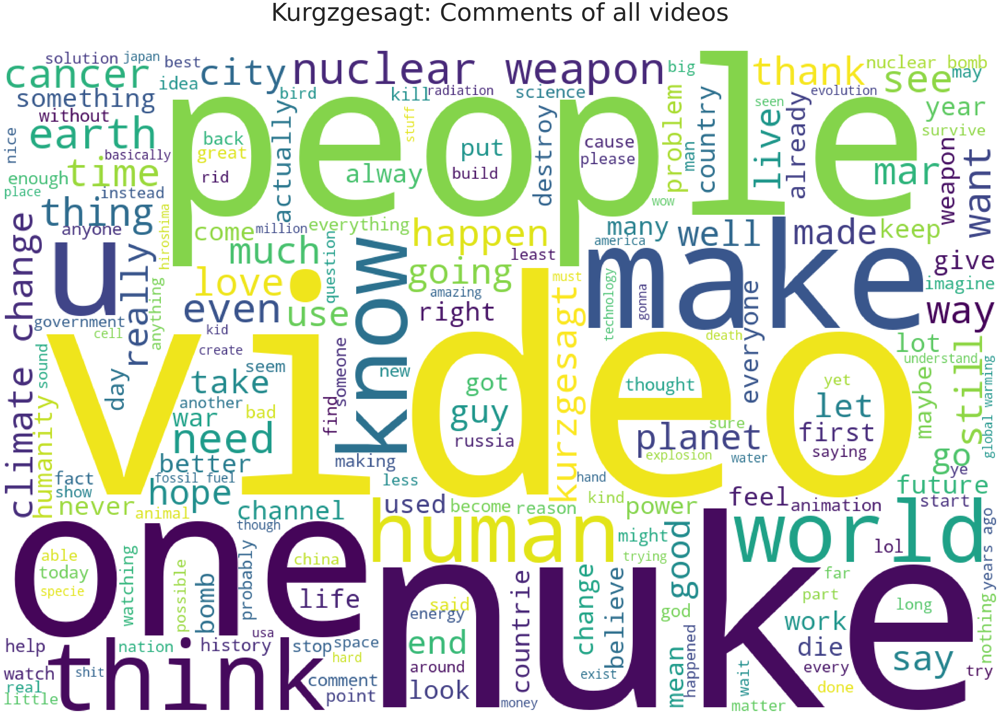

In [14]:
comments_normalized = comments_df.comment.str.lower().str.replace('"',"'")
comments_as_string = " ".join(comments_normalized)

cloud = CreateWordCloud(comments_as_string, stop_words)

plt.figure(figsize = (45, 45), facecolor = None)
plt.imshow(cloud)
plt.axis("off")
plt.tight_layout(pad = 0)

plt.title("Kurgzgesagt: Comments of all videos\n", fontdict={"size":80})
plt.show()

A more in-depth view of the word clouds for each video is shown below.

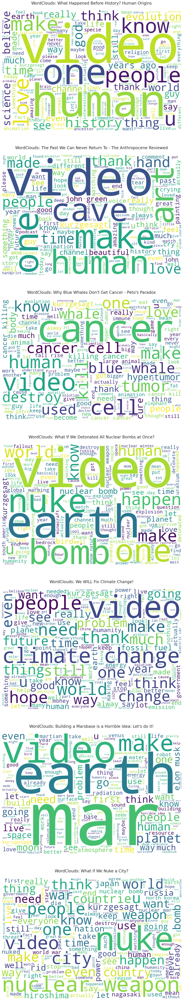

In [15]:
comments_normalized_df = pd.DataFrame({"comments":comments_normalized.to_list()},
                                      index=comments_df["title"])

fig, axis = plt.subplots(len(videos), 1, figsize=(90, 90))

for video_title, ax in zip(videos, axis):
    video_comments = comments_normalized_df.loc[video_title]["comments"]
    video_comments_as_string = " ".join(video_comments)
    
    cloud = CreateWordCloud(video_comments_as_string, stop_words)
    ax.imshow(cloud)
    ax.axis("off")
    ax.set_title(f"WordClouds: {video_title}\n", fontdict={"size":20})
    
fig.subplots_adjust(hspace=0.2)

#### WordCloud by "video"

A funny trend observed in the previous charts is the occurrence of words like "video" appearing in all word clouds. Let's examine the surrounding words of "video" to gather additional information and context about what people are commenting on in relation to this word. In this case, I have chosen three words to the left and three words to the right.

In [16]:
%%time
print("Filtering comments with 'video' words")
comments_related_video = list(filter(lambda x: x.find("video") > -1, comments_normalized))
comments_related_video = pd.Series(comments_related_video)

print("Removing stop words...")
comments_clean = comments_related_video.apply(RemoveStopWords)

print("Tokenizing...")
tokens_per_comments = comments_clean.apply(word_tokenize)
print("Done")

# Three tokens to the left and three to the right of the "video" word
print("Getting tokens (context) of the word 'video'")
context_len = 3
context_video_tokens = tokens_per_comments.apply(GetContextWords, context_len = context_len)

context_video_tokens = list(itertools.chain.from_iterable(context_video_tokens))
context_string = " ".join(context_video_tokens)

Filtering comments with 'video' words
Removing stop words...
Tokenizing...
Done
Getting tokens (context) of the word 'video'
CPU times: user 5.41 s, sys: 47.6 ms, total: 5.46 s
Wall time: 5.46 s


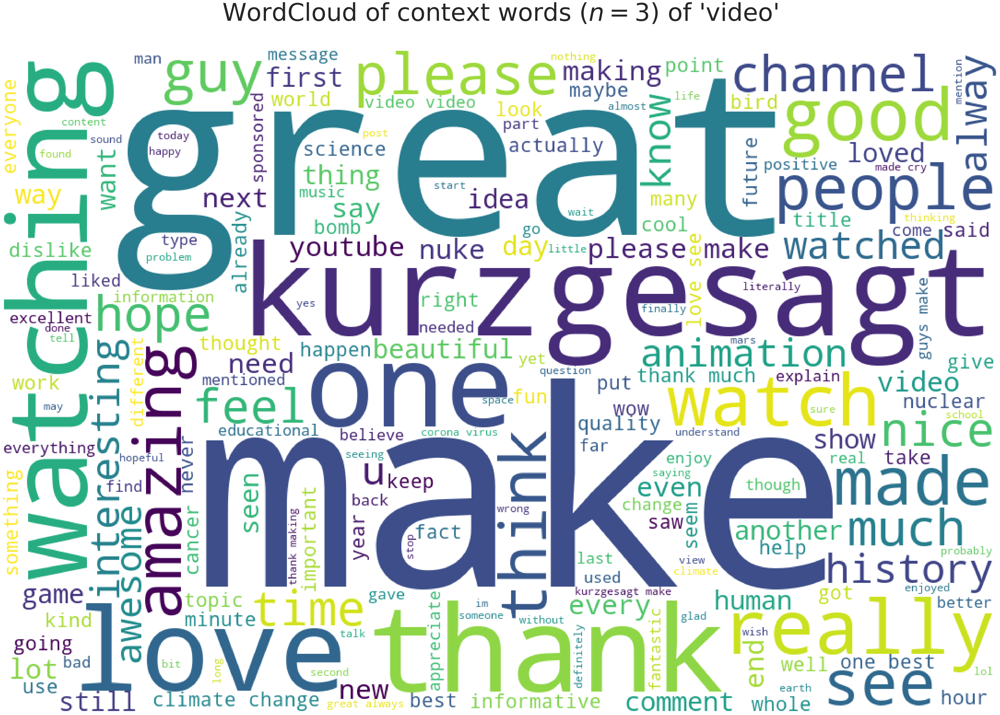

In [17]:
cloud = CreateWordCloud(context_string, stop_words)

plt.figure(figsize = (45, 45), facecolor = None)
plt.imshow(cloud)
plt.axis("off")
plt.tight_layout(pad = 0)

plt.title(f"WordCloud of context words ($n={context_len}$) of 'video'\n", fontdict={"size":80})

plt.show()

Many comments discussing the "video" appear to be positive, as evidenced by the presence of words such as "love," "great," or "amazing" in the word cloud. Additionally, there might be positive comments referring to the channel as a whole, as the name "Kurzgesagt" is one of the most frequently mentioned words.

#### Comments length

What is the distribution of comment lengths? How many characters do the comments typically have? In this short section, I'll examine this aspect.

/home/lromero/mambaforge/envs/DataScience/lib/python3.10/site-packages/bs4/__init__.py:435: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  warnings.warn(


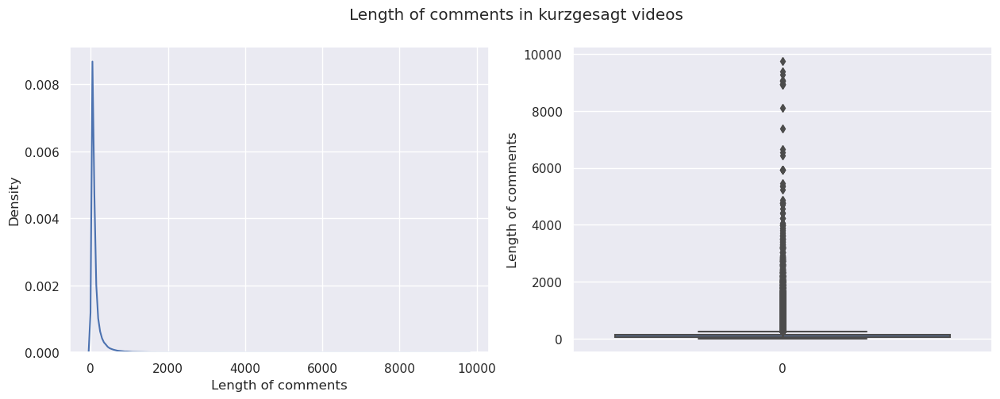

In [18]:
# Object to clean/normalize data
cleaner = CleanText()

kurgz_comments = comments_df["comment"].apply(cleaner.Cleaner)

mask_only_ascii = kurgz_comments.apply(ContainsAscii)
kurgz_comments = kurgz_comments[mask_only_ascii]

mask_only_empty = kurgz_comments.apply(IsEmptyString)
kurgz_comments = kurgz_comments[~mask_only_empty]

len_comments_kurgz = kurgz_comments.apply(StringLen)

fig, axis = plt.subplots(1,2, figsize=(15,5))
sns.kdeplot(len_comments_kurgz, ax=axis[0])
axis[0].set_xlabel("Length of comments")

sns.boxplot(len_comments_kurgz, ax=axis[1])
axis[1].set_ylabel("Length of comments")

plt.suptitle("Length of comments in kurzgesagt videos\n")
plt.show()

In [19]:
percentiles = [0, 0.025, 0.05, 0.25, 0.5, 0.75, 0.95, 0.975, 1]
percentiles_value = []

for per in percentiles:
    percentiles_value.append(len_comments_kurgz.quantile(per))
    
len_comments_kurgz_df = pd.DataFrame({"Percentile":percentiles,
                                      "Comment length":percentiles_value})

len_comments_kurgz_df.set_index("Percentile", inplace=True)
len_comments_kurgz_df

,Comment length
Percentile,
0.000,9.00
0.025,24.00
0.050,27.00
0.250,44.00
0.500,70.00
0.750,128.00
0.950,406.35
0.975,609.00
1.000,9758.00


The majority of comments fall within the range of 9 characters to 609, which accounts for 97.5% of the data.

### Data labeled comments

As a preliminary step before moving on to the sentiment analysis section (next notebook), let's explore the composition of the data that will be used for training. To accomplish this, I will create word clouds for each category of labeled comments and, similar to the previous section, I will also analyze the comment lengths. Finally I'll explore the class distributions of the data set

I will be utilizing a Kaggle dataset that contains YouTube comments already labeled into three classes for sentiment analysis. The classes negative, neutral, and positive are represented by the numbers 0, 1, and 2 respectively.

#### Youtube comments labeled

In [20]:
labeled_comments = pd.read_csv("data/comments.csv", usecols=["Comment","Sentiment"])
labeled_comments.head()

,Comment,Sentiment
0,Let's not forget that Apple Pay in 2014 requir...,1.0
1,Here in NZ 50% of retailers don’t even have co...,0.0
2,I will forever acknowledge this channel with t...,2.0
3,Whenever I go to a place that doesn’t take App...,0.0
4,"Apple Pay is so convenient, secure, and easy t...",2.0


In [21]:
labeled_comments = labeled_comments.drop_duplicates()

classes_map = {
    
    0:"Negative",
    1:"Neutral",
    2:"Positive"

}

labeled_comments["Sentiment"] = labeled_comments["Sentiment"].transform(int).map(classes_map)
labeled_comments["Comment"] = labeled_comments["Comment"].apply(cleaner.Cleaner)

mask_only_ascii = labeled_comments["Comment"].apply(ContainsAscii)
labeled_comments = labeled_comments[mask_only_ascii]

mask_only_empty = labeled_comments["Comment"].apply(IsEmptyString)
labeled_comments = labeled_comments[~mask_only_empty]

/home/lromero/mambaforge/envs/DataScience/lib/python3.10/site-packages/bs4/__init__.py:435: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  warnings.warn(


##### WordCloud by Classes

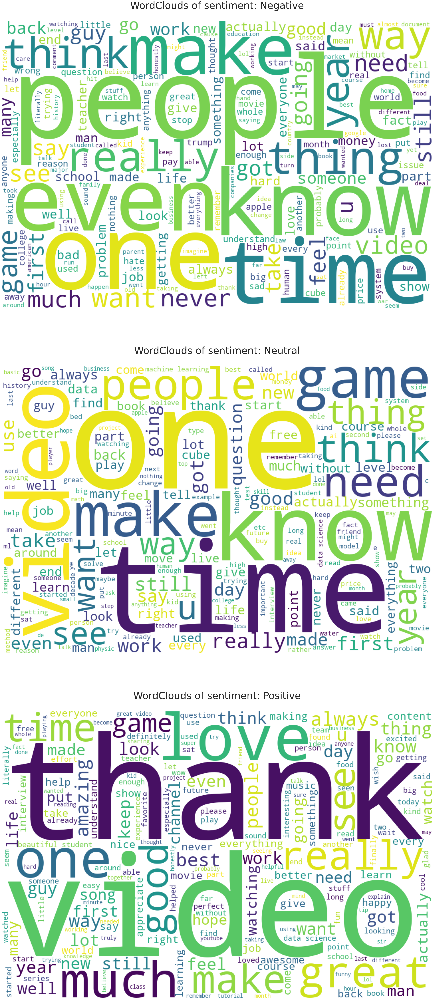

In [22]:
labels_values = np.sort(labeled_comments.Sentiment.unique())
comments_by_labels = {}

fig, axis = plt.subplots(labels_values.shape[0], 1, figsize=(90, 90))

for ax, sentiment in zip(axis, labels_values):
    
    sentiment_comments = labeled_comments.query(f"Sentiment == '{sentiment}'")["Comment"]
    comments_by_labels[sentiment] = sentiment_comments.transform(str).str.lower()
    
    sentiment_comments_as_string = " ".join(comments_by_labels[sentiment])
    
    cloud = CreateWordCloud(sentiment_comments_as_string, stop_words)
    
    ax.imshow(cloud)
    ax.axis("off")
    ax.set_title(f"WordClouds of sentiment: {sentiment}\n", fontdict={"size": 50})
    
fig.subplots_adjust(hspace=0.2)

##### Comments length

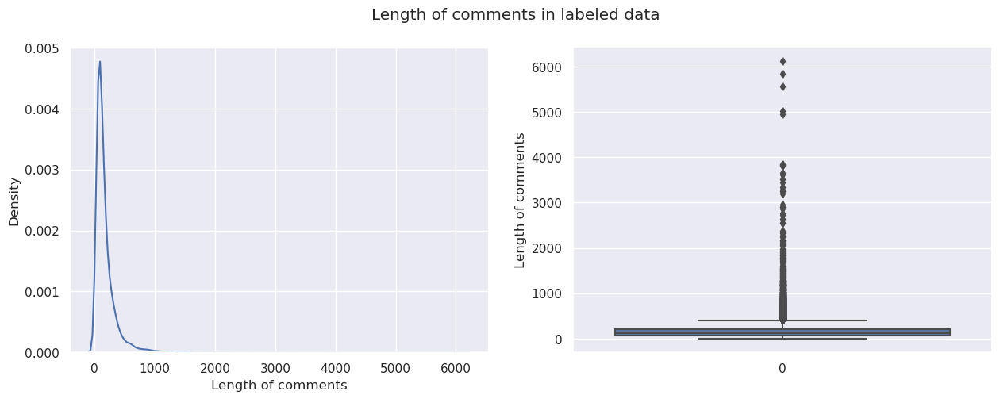

In [35]:
len_comments_lab = labeled_comments.Comment.apply(StringLen)

fig, axis = plt.subplots(1,2, figsize=(15,5))
sns.kdeplot(len_comments_lab, ax=axis[0])
axis[0].set_xlabel("Length of comments")

sns.boxplot(len_comments_lab, ax=axis[1])
axis[1].set_ylabel("Length of comments")

plt.suptitle("Length of comments in labeled data\n")
plt.show()

In [24]:
percentiles = [0, 0.025, 0.05, 0.25, 0.5, 0.75, 0.95, 0.975, 1]
percentiles_value = []
for per in percentiles:
    percentiles_value.append(len_comments_lab.quantile(per))
    
len_comments_lab_df = pd.DataFrame({"Percentile":percentiles,
                                    "Comment length":percentiles_value})
len_comments_lab_df.set_index("Percentile", inplace=True)
len_comments_lab_df

,Comment length
Percentile,
0.000,2.00
0.025,19.00
0.050,28.00
0.250,69.00
0.500,116.00
0.750,205.00
0.950,501.50
0.975,697.75
1.000,6129.00


##### Class distributions

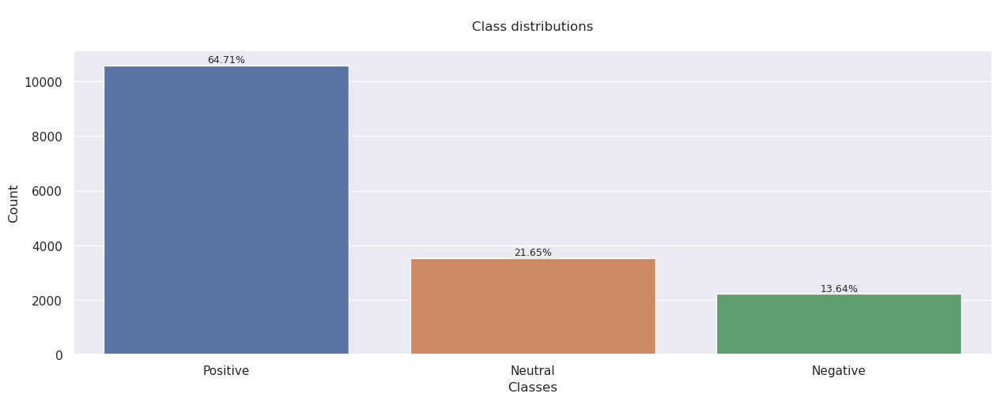

In [26]:
barplot_df = pd.DataFrame(labeled_comments["Sentiment"].value_counts()).reset_index()
barplot_df["Percentage"] = barplot_df["Sentiment"] / barplot_df["Sentiment"].sum() * 100
barplot_df["Percentage"] = barplot_df["Percentage"].apply(round, **{"ndigits":2})
barplot_df["Percentage"] = barplot_df["Percentage"].apply(lambda x: str(x) + "%")

fig, axis = plt.subplots(1,1, figsize=(15,5))

sns.barplot(data=barplot_df, x="index", y="Sentiment", ax=axis)

axis.bar_label(axis.containers[0], labels=list(barplot_df["Percentage"]), size=9)
axis.set_ylabel("Count")
axis.set_xlabel("Classes")
axis.set_title("\nClass distributions\n")

plt.show()

From the previous three charts, we can observe three things, one for each chart:

1. WordClouds: Each wordcloud represents the most common words for each class. However, there is no clear difference among the composition of words for each class, which could pose a problem when training a sentiment analysis algorithm. To address this, I have decided to include another labeled dataset, this time sourced from Twitter.

2. Comment Lengths: The distribution of comment lengths is similar to what we observed in the comments retrieved from YouTube. This time, the range spans from 2 to 698 characters, encompassing 97.5% of the data.

3. Class Distributions: The majority of labeled data belongs to the positive class, resulting in an imbalance in the dataset. However, the degree of imbalance is not as severe as it could be in other tasks, such as fraud detection. In our case, there is an approximate ratio of $3:1$ and $4.7:1$ between the positive class versus the neutral and negative classes, respectively, and a ratio of $1:1.6$ between the neutral and negative classes.

#### Twitter comments

As mentioned earlier, I will incorporate Twitter data and explore the same metrics as in the previous analysis. In addition to the negative and positive classes, this dataset contains labels for the "litigious" and "uncertainty" classes.

In [37]:
comments_twitter = pd.read_csv("data/twittercomments")
comments_twitter.head()

,Text,Language,Label
0,@Charlie_Corley @Kristine1G @amyklobuchar @Sty...,en,litigious
1,#BadBunny: Como dos gotas de agua: Joven se di...,es,negative
2,https://t.co/YJNiO0p1JV Flagstar Bank disclose...,en,litigious
3,Rwanda is set to host the headquarters of Unit...,en,positive
4,OOPS. I typed her name incorrectly (today’s br...,en,litigious


In [38]:
mask_language = comments_twitter.Language == "en"

comments_twitter = comments_twitter[mask_language]

# Cleaning data
comments_twitter["Text"] = comments_twitter["Text"].apply(cleaner.Cleaner, **{"on":"twitter"})
mask_only_ascii = comments_twitter["Text"].apply(ContainsAscii)
comments_twitter = comments_twitter[mask_only_ascii]

mask_only_empty = comments_twitter["Text"].apply(IsEmptyString)
comments_twitter = comments_twitter[~mask_only_empty]

comments_twitter.shape

/home/lromero/mambaforge/envs/DataScience/lib/python3.10/site-packages/bs4/__init__.py:435: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  warnings.warn(


(824713, 3)

##### WordCloud by Classes

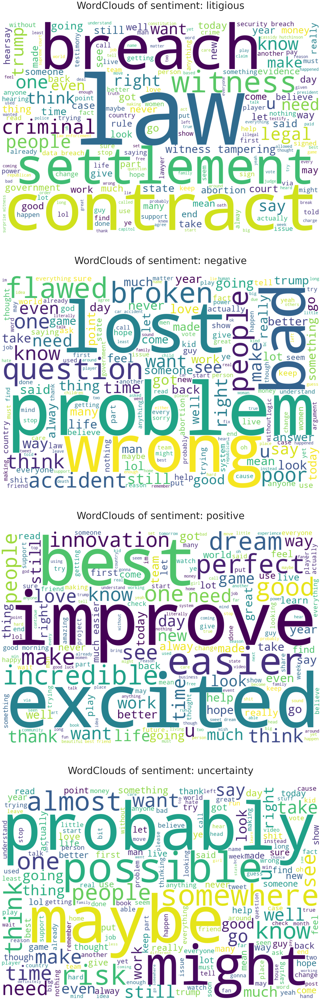

In [39]:
labels_values = np.sort(comments_twitter.Label.unique())
comments_by_labels = {}

fig, axis = plt.subplots(labels_values.shape[0], 1, figsize=(90, 90))

for ax, sentiment in zip(axis, labels_values):
    
    sentiment_comments = comments_twitter.query(f"Label == '{sentiment}'")["Text"]
    comments_by_labels[sentiment] = sentiment_comments.transform(str).str.lower()
    
    sentiment_comments_as_string = " ".join(comments_by_labels[sentiment])
    
    cloud = CreateWordCloud(sentiment_comments_as_string, stop_words)
    
    ax.imshow(cloud)
    ax.axis("off")
    ax.set_title(f"WordClouds of sentiment: {sentiment}\n", fontdict={"size": 50})
    
fig.subplots_adjust(hspace=0.2)

This time, we can observe a clear difference among the classes. Words such as "excited" or "improve" are prominent in the positive class, while words like "bad" or "wrong" stand out in the negative class.

##### Comments length

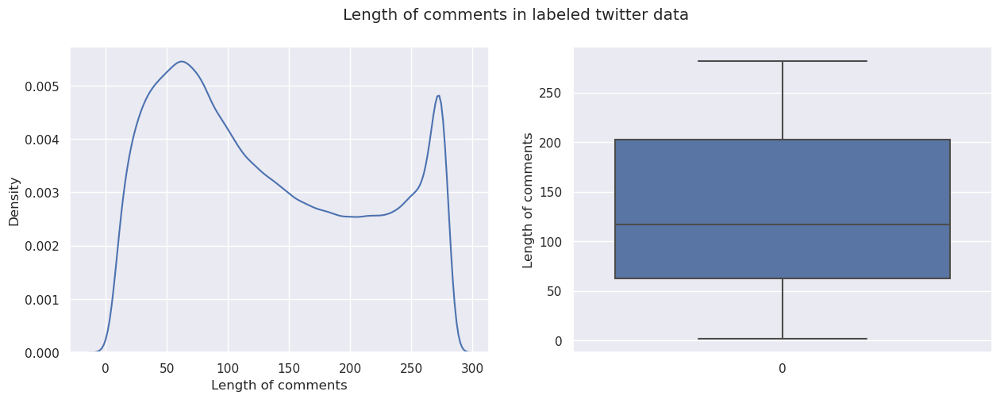

In [41]:
len_comments_twitter = comments_twitter.Text.apply(StringLen)

fig, axis = plt.subplots(1,2, figsize=(15,5))
sns.kdeplot(len_comments_twitter, ax=axis[0])
axis[0].set_xlabel("Length of comments")

sns.boxplot(len_comments_twitter, ax=axis[1])
axis[1].set_ylabel("Length of comments")

plt.suptitle("Length of comments in labeled twitter data\n")
plt.show()

In [34]:
percentiles = [0, 0.025, 0.05, 0.25, 0.5, 0.75, 0.95, 0.975, 1]
percentiles_value = []
for per in percentiles:
    percentiles_value.append(len_comments_twitter.quantile(per))
    
len_comments_lab_twitter_df = pd.DataFrame({"Percentile":percentiles,
                                    "Comment length":percentiles_value})
len_comments_lab_twitter_df.set_index("Percentile", inplace=True)
len_comments_lab_twitter_df

,Comment length
Percentile,
0.000,2.0
0.025,16.0
0.050,23.0
0.250,63.0
0.500,117.0
0.750,203.0
0.950,272.0
0.975,276.0
1.000,282.0


Twitter has (or had?) a limit of characters per tweet. Therefore, it is expected that the length of the characters fell within a well-defined range of distribution.

##### Class distributions

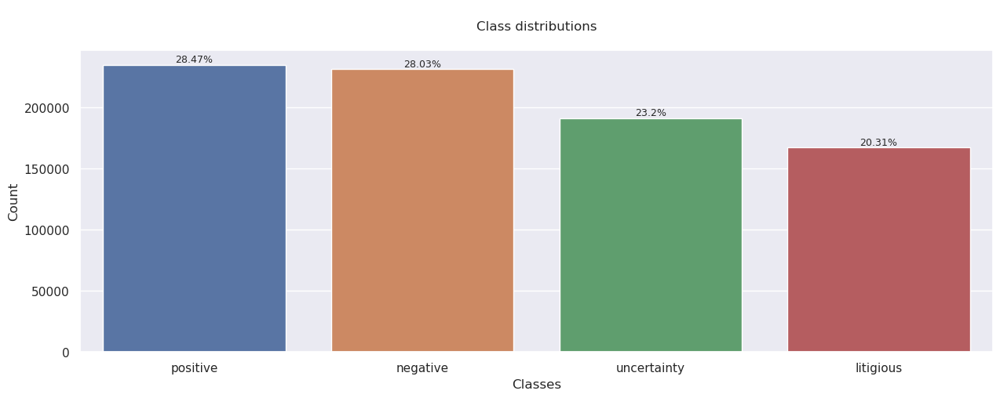

In [52]:
barplot_df = pd.DataFrame(comments_twitter["Label"].value_counts()).reset_index()
barplot_df["Percentage"] = 100 * barplot_df["Label"] / barplot_df["Label"].sum()
barplot_df["Percentage"] = barplot_df["Percentage"].apply(round, **{"ndigits":2})
barplot_df["Percentage"] = barplot_df["Percentage"].apply(lambda x: str(x) + "%")

fig, axis = plt.subplots(1,1, figsize=(15,5))

sns.barplot(data=barplot_df, x="index", y="Label", ax=axis)

axis.bar_label(axis.containers[0], labels=list(barplot_df["Percentage"]), size=9)
axis.set_ylabel("Count")
axis.set_xlabel("Classes")
axis.set_title("\nClass distributions\n")

plt.show()

We can also observed that the class distributions is more balanced.

## Data Processing

In order to obtain suitable data to feed a machine learning model, I will clean and transform the data as follows:

1. I will focus only on three labels: "negative," "other," and "positive." The class "other" will be defined as everything that is not negative or positive, including "neutral," "uncertainty," and "litigious." The classes "negative," "other," and "positive" will be represented by the integers 0, 1, and 2, respectively.

2. The comments/tweets (data) will undergo cleaning, which involves removing HTTP links, HTML, mentions, hashtags, duplicates, non-ASCII characters, and more. Most of this work will be performed by a class defined at the beginning of the notebook in the **Utilities and settings** section, called ```CleanText```.

3. The data will be truncated to 700 characters, a threshold chosen based on the previous analysis of the comments/tweets' length distribution.

4. The data will be tokenized and lemmatized.

Finally, the labeled data from YouTube comments and tweets will be merged to create a single labeled dataset. The comments from Kurzgesagt will be processed in the same manner (steps 1-4).

### Formating data

In [32]:
kurzges_comm_clean = comments_df["comment"]
youtube_comm_clean = pd.read_csv("data/comments.csv", usecols=["Comment","Sentiment"])
twitter_comm_clean = pd.read_csv("data/twittercomments.csv")

In [33]:
# Renaming columns and classes

youtube_comm_clean.columns = ["comment", "class"]
twitter_comm_clean.columns = ["comment", "language", "class"]

# Filtering english language
twitter_comm_clean = twitter_comm_clean.query("language == 'en'")[["comment","class"]]

In [34]:
# Positive 2 and negative 0 will be our main classes, the rest will 
# be treated as "other" 1 class

map_class = {
    
    "negative": 0,
    "litigious": 1,
    "uncertainty": 1,
    "positive": 2,

}

youtube_comm_clean["class"] = youtube_comm_clean["class"].transform(int)
twitter_comm_clean["class"] = twitter_comm_clean["class"].map(map_class)

### Cleaning

In [35]:
def PipelineCleaning(df:pd.DataFrame, text_columns:str, on:str) -> pd.DataFrame:
    
    initial_shape = df.shape
    
    print("Dropping duplicates")
    df = df.drop_duplicates()
    
    print("Converting data type")
    df.loc[:,text_columns] = df[text_columns].transform(str).str.lower()
    
    print("Filtering only ascii")
    df = df[df[text_columns].apply(ContainsAscii)]
    
    print("Cleaning with regex")
    cleaner = CleanText()
    df[text_columns] = df[text_columns].apply(cleaner.Cleaner, **{"on":on})
    
    print("Removing stopwords")
    df.loc[:,text_columns] = df[text_columns].apply(RemoveStopWords)
    
    print("Removing empty strings")
    df = df[~(df[text_columns].apply(IsEmptyString))]
    
    print(f"Initial shape: {initial_shape}")
    print(f"Final shape: {df.shape}\n")
    
    return df

kurzges_comm_clean = PipelineCleaning(pd.DataFrame(kurzges_comm_clean), "comment", "youtube")
youtube_comm_clean = PipelineCleaning(youtube_comm_clean, "comment", "youtube")
twitter_comm_clean = PipelineCleaning(twitter_comm_clean, "comment", "twitter")

Dropping duplicates
Converting data type
Filtering only ascii


/tmp/ipykernel_15500/1567247771.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:,text_columns] = df[text_columns].transform(str).str.lower()


Cleaning with regex


/home/lromero/mambaforge/envs/DataScience/lib/python3.10/site-packages/bs4/__init__.py:435: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  warnings.warn(


Removing stopwords
Removing empty strings
Initial shape: (138679, 1)
Final shape: (135600, 1)

Dropping duplicates
Converting data type
Filtering only ascii
Cleaning with regex


/tmp/ipykernel_15500/1567247771.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:,text_columns] = df[text_columns].transform(str).str.lower()
/home/lromero/mambaforge/envs/DataScience/lib/python3.10/site-packages/bs4/__init__.py:435: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  warnings.warn(


Removing stopwords
Removing empty strings
Initial shape: (18409, 2)
Final shape: (13151, 2)

Dropping duplicates
Converting data type
Filtering only ascii
Cleaning with regex
Removing stopwords
Removing empty strings
Initial shape: (871310, 2)
Final shape: (690868, 2)



### Truncating string

In [36]:
# Truncate string according to comment length shown in EDA
kurzges_comm_clean["comment"] = kurzges_comm_clean["comment"].apply(TruncateText, **{"max_length": 700})
youtube_comm_clean["comment"] = youtube_comm_clean["comment"].apply(TruncateText, **{"max_length": 700})
twitter_comm_clean["comment"] = twitter_comm_clean["comment"].apply(TruncateText, **{"max_length": 700})

### Tokenization and Lemmatization

In [37]:
# Concate youtube and twitter dataFrames
labeled_comments = pd.concat([twitter_comm_clean, youtube_comm_clean])
labeled_comments["class"] = pd.Series(labeled_comments["class"], dtype="int8")

del twitter_comm_clean, youtube_comm_clean
gc.collect()

91504

In [42]:
%%time

labeled_comments["comment"] = labeled_comments["comment"].apply(LemmatizeWithPos)
kurzges_comm_clean["comment"] = kurzges_comm_clean["comment"].apply(LemmatizeWithPos)

CPU times: user 15min 10s, sys: 7.56 s, total: 15min 17s
Wall time: 15min 17s


### Saving clean data

In [46]:
labeled_comments.reset_index(drop=True).to_feather("data/labeled_data_clean.feather")
kurzges_comm_clean.reset_index(drop=True).to_feather("data/kurzgesagt_clean.feather")